In [1]:
import pandas as pd
pd.set_option('display.max_columns', None) # Show all columns
pd.set_option('display.max_rows', None)      # Limit number of rows shown
pd.set_option('display.width', 1000)       # Width of the display in characters

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import scipy.stats as stats
import seaborn as sns
from sklearn import linear_model
import statsmodels.api as sm 
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder, FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, BaggingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.impute import SimpleImputer

In [3]:
price = pd.read_csv('Ames_HousePrice.csv')
price.drop(columns=['Unnamed: 0'], inplace=True)
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,484.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Normal
9,9081860

In [4]:
columns_to_sum = [
    'PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF',
    '3SsnPorch', 'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalArea'] = price[columns_to_sum].fillna(0).sum(axis=1)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal,2277.0
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2618.0
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal,2336.0
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal,2004.0
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal,3048.0
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal,3271.0
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2592.0
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial,2964.0
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,

In [5]:
columns_to_sum1 = [
    'BsmtFullBath', 'FullBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalFullBath'] = price[columns_to_sum1].fillna(0).sum(axis=1)

columns_to_sum2 = [
    'BsmtHalfBath', 'HalfBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalHalfBath'] = price[columns_to_sum2].fillna(0).sum(axis=1)

In [6]:
price['Alley'] = price['Alley'].fillna('No Alley Access')
price['MasVnrType'] = price['MasVnrType'].fillna('None')
price['BsmtQual'] = price['BsmtQual'].fillna('No Basement')
price['BsmtCond'] = price['BsmtCond'].fillna('No Basement')
price['BsmtExposure'] = price['BsmtExposure'].fillna('No Basement')
price['BsmtFinType1'] = price['BsmtFinType1'].fillna('No Basement')
price['BsmtFinType2'] = price['BsmtFinType2'].fillna('No Basement')
price['FireplaceQu'] = price['FireplaceQu'].fillna('No Fireplace')
price['GarageType'] = price['GarageType'].fillna('No Garage')
price['GarageYrBlt'] = price['GarageYrBlt'].fillna('No Garage')
price['GarageFinish'] = price['GarageFinish'].fillna('No Garage')
price['GarageQual'] = price['GarageQual'].fillna('No Garage')
price['GarageCond'] = price['GarageCond'].fillna('No Garage')
price['PoolQC'] = price['PoolQC'].fillna('No Pool')
price['Fence'] = price['Fence'].fillna('No Fence')
price['MiscFeature'] = price['MiscFeature'].fillna('None')

In [7]:
price.loc[price['MasVnrType'] == 'None', 'MasVnrArea'] = 0
price.loc[price['BsmtFinType1'] == 'No Basement', 'BsmtFinSF1'] = 0
price.loc[price['BsmtFinType2'] == 'No Basement', 'BsmtFinSF2'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtUnfSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'TotalBsmtSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtFullBath'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtHalfBath'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageCars'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageArea'] = 0

In [8]:
price['MasVnrArea'] = price['MasVnrArea'].fillna(0).astype('int64')
price['BsmtFinSF1'] = price['BsmtFinSF1'].fillna(0).astype('int64')
price['BsmtFinSF2'] = price['BsmtFinSF2'].fillna(0).astype('int64')
price['BsmtUnfSF'] = price['BsmtUnfSF'].fillna(0).astype('int64')
price['TotalBsmtSF'] = price['TotalBsmtSF'].fillna(0).astype('int64')
price['BsmtFullBath'] = price['BsmtFullBath'].fillna(0).astype('int64')
price['GarageCars'] = price['GarageCars'].fillna(0).astype('int64')
price['BsmtHalfBath'] = price['BsmtHalfBath'].fillna(0).astype('int64')
price['GarageArea'] = price['GarageArea'].fillna(0).astype('int64')

In [9]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].mean())

In [10]:
# Select variables
features = ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual']
target = 'SalePrice'

multi_feats = price[features + [target]].fillna(0)

# Define X and y
X = multi_feats[features]
y = multi_feats[target]
 

preprocessor = ColumnTransformer([
    ('pass', 'passthrough', ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual'])
])
 
# Final pipeline with Decision Tree
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9990
RMSE (Train): 2,320.35
CV R² scores: [0.68804613 0.67788731 0.77496923 0.72618245 0.74428416]
Mean CV R²: 0.7222738552669015


In [11]:
# Select variables
features = ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual']
target = 'SalePrice'

multi_feats = price[features + [target]].fillna(0)

# Define X and y
X = multi_feats[features]
y = multi_feats[target]
 

preprocessor = ColumnTransformer([
    ('pass', 'passthrough', ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual'])
])
 
# Final pipeline with Random Forest
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9755
RMSE (Train): 11,730.00
CV R² scores: [0.79502816 0.80296149 0.86566738 0.84007509 0.84720467]
Mean CV R²: 0.8301873565537798


In [12]:
# Convert the below numeric features to categorical features
price['MSSubClass'] = price['MSSubClass'].astype('object')
price['YrSold'] = price['YrSold'].astype('object')
price['MoSold'] = price['MoSold'].astype('object')
 
# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
}
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())

In [13]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice'

# Separate X and y
X = price[features]
y = price[target]

# Categorical features
categorical_cols = ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass']
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('ord', ordinal_transformer, ordinal_features),
        ('cat', categorical_transformer, categorical_cols)
    ],      
    remainder='passthrough'
)


# Final pipeline with Decision Tree
model_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
model_pipeline.fit(X, y)
y_pred = model_pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(model_pipeline, X, y) #, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9998
RMSE (Train): 1,082.20
CV R² scores: [0.77839621 0.81373239 0.83174288 0.80639973 0.82906122]
Mean CV R²: 0.8118664838273029


In [14]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice'

# Separate X and y
X = price[features]
y = price[target]

# Categorical features
categorical_cols = ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass']
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('ord', ordinal_transformer, ordinal_features),
        ('cat', categorical_transformer, categorical_cols)
    ],      
    remainder='passthrough'
)

# Final pipeline with Random Forest
model_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fit and predict
model_pipeline.fit(X, y)
y_pred = model_pipeline.predict(X)

# Evaluate on full data
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(model_pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9840
RMSE (Train): 9,481.30
CV R² scores: [0.84727519 0.86843839 0.91233583 0.89781483 0.90838453]
Mean CV R²: 0.8868497541038518


In [15]:
# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', categorical_transformer, ['Neighborhood']) 
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Final pipeline with Decision Tree
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9966
RMSE (Train): 4,352.85
CV R² scores: [0.63238256 0.63611931 0.70040328 0.61592113 0.6660896 ]
Mean CV R²: 0.650183174285904


In [16]:
# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', categorical_transformer, ['Neighborhood']) 
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Final pipeline with Random Forest
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9677
RMSE (Train): 13,483.76
CV R² scores: [0.75191446 0.79496269 0.81825196 0.77888538 0.75469762]
Mean CV R²: 0.7797424217447255


In [17]:
price.isnull().sum()

PID              0
GrLivArea        0
SalePrice        0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
Alley            0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr

In [18]:
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2.0,0.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3.0,0.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1.0,0.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1.0,0.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3.0,1.0
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3.0,0.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1.0,0.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3,2008,New,Partial,2964.0,2.0,0.0
8,923426010,889,137500,20,RL,74.000000,1239

In [19]:
price.isnull().sum()

PID              0
GrLivArea        0
SalePrice        0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
Alley            0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr

In [20]:
# 2. Create the model
ols = linear_model.LinearRegression()

# Select only numerical columns
numerical_cols = price.select_dtypes(include=[np.number]).columns

# Target variable
y = price['SalePrice']

# Empty dictionary to store R² values
r2_scores = {}

for col in numerical_cols:
    if col != 'SalePrice':  # skip the target itself
        if price[col].isnull().sum() == 0:  # check if no missing values
            X = price[[col]]  # must be 2D
            ols.fit(X, y)
            r2 = ols.score(X, y)  # get R²
            r2_scores[col] = r2
        else:
            pass  # skip columns with NaN

# 6. Sort results by R² descending
sorted_r2 = dict(sorted(r2_scores.items(), key=lambda item: item[1], reverse=True))

# 7. Display nicely
for feature, r2 in sorted_r2.items():
    print(f"{feature}: R² = {r2:.4f}")

TotalArea: R² = 0.7311
OverallQual: R² = 0.6249
GrLivArea: R² = 0.5184
TotalBsmtSF: R² = 0.4257
1stFlrSF: R² = 0.4130
GarageCars: R² = 0.4070
GarageArea: R² = 0.4023
TotalFullBath: R² = 0.3541
YearBuilt: R² = 0.2963
FullBath: R² = 0.2862
YearRemodAdd: R² = 0.2645
MasVnrArea: R² = 0.2478
TotRmsAbvGrd: R² = 0.2403
Fireplaces: R² = 0.2383
BsmtFinSF1: R² = 0.2126
LotFrontage: R² = 0.1145
WoodDeckSF: R² = 0.1110
OpenPorchSF: R² = 0.0940
BsmtFullBath: R² = 0.0845
HalfBath: R² = 0.0817
LotArea: R² = 0.0753
2ndFlrSF: R² = 0.0692
TotalHalfBath: R² = 0.0619
PID: R² = 0.0512
BsmtUnfSF: R² = 0.0282
BedroomAbvGr: R² = 0.0230
EnclosedPorch: R² = 0.0152
ScreenPorch: R² = 0.0148
KitchenAbvGr: R² = 0.0130
OverallCond: R² = 0.0102
BsmtHalfBath: R² = 0.0011
3SsnPorch: R² = 0.0010
PoolArea: R² = 0.0010
LowQualFinSF: R² = 0.0010
BsmtFinSF2: R² = 0.0004
MiscVal: R² = 0.0004


In [21]:
# Automatically detect categorical columns
categorical_cols = price.select_dtypes(include='object').columns.tolist()
target = 'SalePrice'

# Fill missing values
price[categorical_cols] = price[categorical_cols].fillna('Missing')
price[target] = price[target].fillna(0)

# Collect (feature, r²) pairs
r2_results = []

for col in categorical_cols:
    X = price[[col]].fillna('Missing').astype(str)
    y = price[target]

    preprocessor = ColumnTransformer(
        transformers=[
            ('cat', OneHotEncoder(drop='first'), [col])
        ]
    )

    pipeline = Pipeline([
        ('prep', preprocessor),
        ('reg', LinearRegression())
    ])

    pipeline.fit(X, y)
    y_pred = pipeline.predict(X)
    r2 = r2_score(y, y_pred)

    r2_results.append((col, r2))

# Sort results descending by R²
r2_results_sorted = sorted(r2_results, key=lambda x: x[1], reverse=True)

# Print
for col, r2 in r2_results_sorted:
    print(f"{col}: R² = {r2:.4f}")

Neighborhood: R² = 0.5598
ExterQual: R² = 0.4853
BsmtQual: R² = 0.4814
KitchenQual: R² = 0.4579
GarageYrBlt: R² = 0.3896
FireplaceQu: R² = 0.3010
GarageFinish: R² = 0.2906
Foundation: R² = 0.2671
MSSubClass: R² = 0.2399
GarageType: R² = 0.2344
BsmtFinType1: R² = 0.2291
HeatingQC: R² = 0.2024
BsmtExposure: R² = 0.1812
MasVnrType: R² = 0.1711
Exterior1st: R² = 0.1551
Exterior2nd: R² = 0.1538
MSZoning: R² = 0.1160
LotShape: R² = 0.0942
GarageQual: R² = 0.0869
SaleType: R² = 0.0813
GarageCond: R² = 0.0782
PavedDrive: R² = 0.0725
SaleCondition: R² = 0.0722
HouseStyle: R² = 0.0710
CentralAir: R² = 0.0664
RoofStyle: R² = 0.0587
Electrical: R² = 0.0566
BsmtCond: R² = 0.0499
Condition1: R² = 0.0453
Fence: R² = 0.0362
BldgType: R² = 0.0330
LandContour: R² = 0.0323
BsmtFinType2: R² = 0.0297
Condition2: R² = 0.0247
ExterCond: R² = 0.0220
LotConfig: R² = 0.0211
RoofMatl: R² = 0.0208
Alley: R² = 0.0202
Functional: R² = 0.0137
PoolQC: R² = 0.0118
Heating: R² = 0.0079
LandSlope: R² = 0.0063
MoSold: R²

/var/folders/cl/t0tgh5md7pj6srx85p45398h0000gq/T/ipykernel_23462/2308409545.py:6: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  price[categorical_cols] = price[categorical_cols].fillna('Missing')


In [22]:
# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
}
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())

# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]


# Categorical features
categorical_cols = ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'MSZoning', 'LotConfig', 'LandContour',
                   'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir', 'SaleType']
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('ord', ordinal_transformer, ordinal_features),
        ('cat', categorical_transformer, categorical_cols)
    ],      
    remainder='passthrough'
)


# Final pipeline with Decision Tree
model_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
model_pipeline.fit(X, y)
y_pred = model_pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(model_pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 1.0000
RMSE (Train): 465.20
CV R² scores: [0.69895423 0.8015879  0.80402972 0.77361259 0.81174981]
Mean CV R²: 0.7779868501375388


In [23]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]


# Categorical features
categorical_cols = ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'MSZoning', 'LotConfig', 'LandContour',
                   'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir', 'SaleType']
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('ord', ordinal_transformer, ordinal_features),
        ('cat', categorical_transformer, categorical_cols)
    ],      
    remainder='passthrough'
)

# Final pipeline with Random Forest
model_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fit model
model_pipeline.fit(X, y)
y_pred = model_pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(model_pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9838
RMSE (Train): 9,533.52
CV R² scores: [0.83935204 0.86979804 0.90441707 0.90298147 0.89517526]
Mean CV R²: 0.8823447750352311


In [24]:
# Define what counts as a finished basement
finished_basement_types = ['GLQ', 'ALQ', 'BLQ', 'Rec', 'LwQ']

# Create new total room feature including finished basement types
price['TotalFinishedRooms'] = (
    price['TotRmsAbvGrd'] +
    price['BsmtFinType1'].apply(lambda x: 1 if x in finished_basement_types else 0) +
    price['BsmtFinType2'].apply(lambda x: 1 if x in finished_basement_types else 0)
)

price['TotalBathrooms'] = (
    price['FullBath'].fillna(0) +
    price['HalfBath'].fillna(0) * 0.5 +
    price['BsmtFullBath'].fillna(0) +
    price['BsmtHalfBath'].fillna(0) * 0.5
)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath,TotalFinishedRooms,TotalBathrooms
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2.0,0.0,5,2.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3.0,0.0,7,3.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1.0,0.0,6,1.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1.0,0.0,6,1.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3.0,1.0,7,3.5
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3.0,0.0,7,3.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1.0,0.0,4,1.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3

In [25]:
# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
}

# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())

# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 


# Separate predictors and response
X = price[features]
y = price[target]


# Categorical features
categorical_cols = ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass']
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('ord', ordinal_transformer, ordinal_features),
        ('cat', categorical_transformer, categorical_cols)
    ],      
    remainder='passthrough'
)


# Final pipeline with Decision Tree
model_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
model_pipeline.fit(X, y)
y_pred = model_pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(model_pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9998
RMSE (Train): 1,082.20
CV R² scores: [0.77839621 0.81373239 0.83174288 0.80639973 0.82906122]
Mean CV R²: 0.8118664838273029


In [26]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

 
# Categorical features
categorical_cols = ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass']
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('ord', ordinal_transformer, ordinal_features),
        ('cat', categorical_transformer, categorical_cols)
    ],      
    remainder='passthrough'
)


# Final pipeline with Random Forest
model_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fit model
model_pipeline.fit(X, y)
y_pred = model_pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(model_pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9840
RMSE (Train): 9,481.30
CV R² scores: [0.84727519 0.86843839 0.91233583 0.89781483 0.90838453]
Mean CV R²: 0.8868497541038518


In [27]:
mode_val = price['Electrical'].mode(dropna=True)[0] 
price['Electrical'] = price['Electrical'].fillna(mode_val)

In [28]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].mean())

In [29]:
X = price[numeric_features]
 
# Target variable
y = price['SalePrice']

preprocessor = ColumnTransformer([
    ('pass', 'passthrough', numeric_features)
])
 
# Final pipeline with Decision Tree
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 1.0000
RMSE (Train): 132.90
CV R² scores: [0.77245639 0.8305762  0.7438657  0.7583035  0.75849039]
Mean CV R²: 0.772738437135976


In [30]:
X = price[numeric_features]
 
# Target variable
y = price['SalePrice']

preprocessor = ColumnTransformer([
    ('pass', 'passthrough', numeric_features)
])
 
# Final pipeline with Random Forest
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9855
RMSE (Train): 9,037.43
CV R² scores: [0.85891586 0.88261602 0.91976684 0.90198011 0.89940688]
Mean CV R²: 0.8925371395647902


In [41]:
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']
 
# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

In [43]:
X = pd.concat([price[categorical_features], price[electrical_feature]], axis = 1)
 
# Target variable
y = price['SalePrice']

# Pipeline for 'Electrical': Fill missing value with mode then apply ordinal encoding
electrical_transformer = Pipeline(steps=[
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
])
 


# Final pipeline with Decision Tree
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9998
RMSE (Train): 1,160.04
CV R² scores: [0.61647587 0.62854266 0.58388012 0.60092175 0.59450958]
Mean CV R²: 0.604865995417317


In [45]:
X = pd.concat([price[categorical_features], price[electrical_feature]], axis = 1)
 
# Target variable
y = price['SalePrice']

# Pipeline for 'Electrical': Fill missing value with mode then apply ordinal encoding
electrical_transformer = Pipeline(steps=[
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
])
 
# Final pipeline with Random Forest
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9692
RMSE (Train): 13,155.51
CV R² scores: [0.76642879 0.79217924 0.75596322 0.79560962 0.80271347]
Mean CV R²: 0.782578868856435


In [46]:
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

X = pd.concat([price[numeric_features], price[categorical_features], price[electrical_feature]], axis=1)
 
# Target variable
y = price['SalePrice']
 
# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']
 
# Pipeline for 'Electrical': Fill missing value with mode then apply ordinal encoding
electrical_transformer = Pipeline(steps=[
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
    ],
    remainder='passthrough'
)
 


# Final pipeline with Decision Tree
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 1.0000
RMSE (Train): 65.67
CV R² scores: [0.73885428 0.82651767 0.79432286 0.77586502 0.81385512]
Mean CV R²: 0.7898829899360839


In [47]:
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'TotalArea', 'TotalBathrooms']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

X = pd.concat([price[numeric_features], price[categorical_features], price[electrical_feature]], axis=1)
 
# Target variable
y = price['SalePrice']
 
# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']
 
# Pipeline for 'Electrical': Fill missing value with mode then apply ordinal encoding
electrical_transformer = Pipeline(steps=[
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
    ],
    remainder='passthrough'
)
 


# Final pipeline with Decision Tree
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', DecisionTreeRegressor(random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 1.0000
RMSE (Train): 65.67
CV R² scores: [0.74145012 0.82413564 0.73664426 0.80536567 0.74196799]
Mean CV R²: 0.7699127360628074


In [48]:
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

X = pd.concat([price[numeric_features], price[categorical_features], price[electrical_feature]], axis=1)
 
# Target variable
y = price['SalePrice']
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']
 
# Pipeline for 'Electrical': Fill missing value with mode then apply ordinal encoding
electrical_transformer = Pipeline(steps=[
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
    ],
    remainder='passthrough'
)

# Final pipeline with Random Forest
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=200, random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9861
RMSE (Train): 8,841.35
CV R² scores: [0.86349944 0.89134203 0.92379989 0.9094925  0.90933292]
Mean CV R²: 0.899493354493287


In [49]:
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'TotalArea', 'TotalBathrooms']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

X = pd.concat([price[numeric_features], price[categorical_features], price[electrical_feature]], axis=1)
 
# Target variable
y = price['SalePrice']
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']
 
# Pipeline for 'Electrical': Fill missing value with mode then apply ordinal encoding
electrical_transformer = Pipeline(steps=[
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
# Pipeline for ordinal features: Fill missing values with 'None' then apply ordinal encoding
ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
# Pipeline for nominal categorical features: Fill missing values with 'None' then apply one-hot encoding
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
    ],
    remainder='passthrough'
)

# Final pipeline with Random Forest
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', RandomForestRegressor(n_estimators=200, random_state=42))
])

# Fit model
pipeline.fit(X, y)
y_pred = pipeline.predict(X)

# Evaluation
r2 = r2_score(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Cross-validation
cv_scores = cross_val_score(pipeline, X, y, cv=5, scoring='r2', n_jobs=-1)

# Output
print(f"R² (Train): {r2:.4f}")
print(f"RMSE (Train): {rmse:,.2f}")
print("CV R² scores:", cv_scores)
print("Mean CV R²:", np.mean(cv_scores))

R² (Train): 0.9853
RMSE (Train): 9,099.57
CV R² scores: [0.84284571 0.89486849 0.90457454 0.91659468 0.91549435]
Mean CV R²: 0.8948755543621582


In [50]:
# Adjust data types for categorical variables
for col in ['MSSubClass', 'YrSold', 'MoSold']:
    price[col] = price[col].astype('object')
 
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

# Define transformations for various feature types
electrical_transformer = Pipeline(steps=[
    ('impute_electrical', SimpleImputer(strategy='most_frequent')),
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
numeric_transformer = Pipeline(steps=[
    ('impute_mean', SimpleImputer(strategy='mean'))
])
 
# Updated categorical imputer using SimpleImputer
categorical_imputer = SimpleImputer(strategy='constant', fill_value='None')
 
ordinal_transformer = Pipeline([
    ('impute_ordinal', categorical_imputer),
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline([
    ('impute_nominal', categorical_imputer),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('num', numeric_transformer, numeric_features),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
])
 
# Define model pipelines including Gradient Boosting Regressor
models = {
    'Decision Tree (1 Tree)': DecisionTreeRegressor(random_state=42),
    'Bagging Regressor (100 Decision Trees)': BaggingRegressor(estimator=DecisionTreeRegressor(random_state=42),
                                                      n_estimators=100, random_state=42),
    'Bagging Regressor (200 Decision Trees)': BaggingRegressor(estimator=DecisionTreeRegressor(random_state=42),
                                                      n_estimators=200, random_state=42),
    'Random Forest (Default of 100 Trees)': RandomForestRegressor(random_state=42),
    'Random Forest (200 Trees)': RandomForestRegressor(n_estimators=200, random_state=42),
    'Gradient Boosting Regressor (Default of 100 Trees)': GradientBoostingRegressor(random_state=42),
    'Gradient Boosting Regressor (200 Trees)': GradientBoostingRegressor(n_estimators=200, random_state=42)
}
 
# Evaluate models using cross-validation and print results
results = {}
for name, model in models.items():
    model_pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('regressor', model)
    ])
    
    # Perform 5-fold cross-validation
    scores = cross_val_score(
        model_pipeline,
        price.drop(columns=['SalePrice', 'PID']),
        price['SalePrice'],
        cv=5,
        scoring='r2'
    )
    
    # Store mean R²
    results[name] = round(scores.mean(), 4)
    
    # Print all 5 CV scores and their mean
    print(f"\n{name} With Total Area/Bsmt:")
    print(f"5 CV R² scores: {np.round(scores, 4)}")
    print(f"Mean CV R²: {scores.mean():.4f}")


Decision Tree (1 Tree) With Total Area/Bsmt:
5 CV R² scores: [0.7646 0.7556 0.7998 0.6996 0.8041]
Mean CV R²: 0.7647

Bagging Regressor (100 Decision Trees) With Total Area/Bsmt:
5 CV R² scores: [0.8638 0.888  0.9241 0.906  0.9089]
Mean CV R²: 0.8982

Bagging Regressor (200 Decision Trees) With Total Area/Bsmt:
5 CV R² scores: [0.8657 0.8894 0.9251 0.9096 0.9113]
Mean CV R²: 0.9002

Random Forest (Default of 100 Trees) With Total Area/Bsmt:
5 CV R² scores: [0.8598 0.8874 0.9242 0.9081 0.9071]
Mean CV R²: 0.8973

Random Forest (200 Trees) With Total Area/Bsmt:
5 CV R² scores: [0.8628 0.8893 0.9242 0.9094 0.9108]
Mean CV R²: 0.8993

Gradient Boosting Regressor (Default of 100 Trees) With Total Area/Bsmt:
5 CV R² scores: [0.8571 0.9077 0.933  0.9241 0.9333]
Mean CV R²: 0.9110

Gradient Boosting Regressor (200 Trees) With Total Area/Bsmt:
5 CV R² scores: [0.8609 0.9142 0.935  0.9302 0.9383]
Mean CV R²: 0.9157


In [51]:
# Adjust data types for categorical variables
for col in ['MSSubClass', 'YrSold', 'MoSold']:
    price[col] = price[col].astype('object')
 
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 
                                                                                   'TotalArea']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

# Define transformations for various feature types
electrical_transformer = Pipeline(steps=[
    ('impute_electrical', SimpleImputer(strategy='most_frequent')),
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
numeric_transformer = Pipeline(steps=[
    ('impute_mean', SimpleImputer(strategy='mean'))
])
 
# Updated categorical imputer using SimpleImputer
categorical_imputer = SimpleImputer(strategy='constant', fill_value='None')
 
ordinal_transformer = Pipeline([
    ('impute_ordinal', categorical_imputer),
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline([
    ('impute_nominal', categorical_imputer),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('num', numeric_transformer, numeric_features),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
])
 
# Define model pipelines including Gradient Boosting Regressor
models = {
    'Decision Tree (1 Tree)': DecisionTreeRegressor(random_state=42),
    'Bagging Regressor (200 Decision Trees)': BaggingRegressor(estimator=DecisionTreeRegressor(random_state=42),
                                                      n_estimators=200, random_state=42),
    'Random Forest (200 Trees)': RandomForestRegressor(n_estimators=200, random_state=42),
    'Gradient Boosting Regressor (200 Trees)': GradientBoostingRegressor(n_estimators=200, random_state=42)
}
 
# Collect all CV scores in a list
cv_results = []
for name, model in models.items():
    model_pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('regressor', model)
    ])
    
    # Perform 5-fold cross-validation
    scores = cross_val_score(
        model_pipeline,
        price.drop(columns=['SalePrice', 'PID', 'TotalArea']),
        price['SalePrice'],
        cv=5,
        scoring='r2'
    )
    
    # Store mean R²
    results[name] = round(scores.mean(), 4)
    
    # Print all 5 CV scores and their mean
    print(f"\n{name}:")
    print(f"5 CV R² scores: {np.round(scores, 4)}")
    print(f"Mean CV R²: {scores.mean():.4f}")

    # Append each score with its model name to the list
    for score in scores:
        cv_results.append({'Model': name, 'R2 Score': score})


Decision Tree (1 Tree):
5 CV R² scores: [0.6996 0.8163 0.7842 0.7484 0.7723]
Mean CV R²: 0.7642

Bagging Regressor (200 Decision Trees):
5 CV R² scores: [0.8462 0.8903 0.9021 0.9129 0.9141]
Mean CV R²: 0.8931

Random Forest (200 Trees):
5 CV R² scores: [0.847  0.8922 0.9021 0.9135 0.9132]
Mean CV R²: 0.8936

Gradient Boosting Regressor (200 Trees):
5 CV R² scores: [0.8389 0.9085 0.9319 0.9338 0.9344]
Mean CV R²: 0.9095


/var/folders/cl/t0tgh5md7pj6srx85p45398h0000gq/T/ipykernel_23462/3377737860.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Model', y='R2 Score', data=cv_df, palette='hsv')


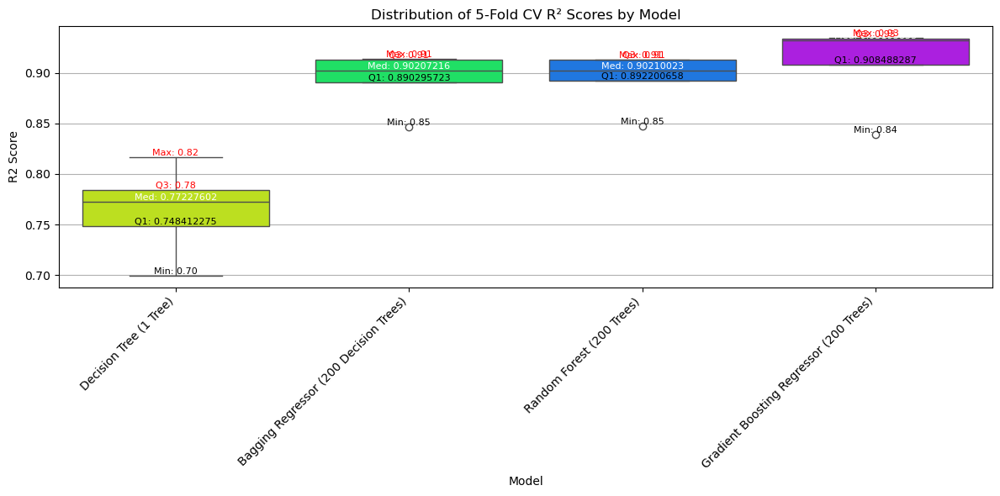

In [52]:
# Convert to DataFrame
cv_df = pd.DataFrame(cv_results)

plt.figure(figsize=(12, 6))
sns.boxplot(x='Model', y='R2 Score', data=cv_df, palette='hsv')
plt.title('Distribution of 5-Fold CV R² Scores by Model')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y')

# Loop through each model and annotate its box with its 5-number summary
models = cv_df['Model'].unique()
for i, model in enumerate(models):
    scores = cv_df[cv_df['Model'] == model]['R2 Score']
    minimum = scores.min()
    q1 = scores.quantile(0.25)
    median = scores.median()
    q3 = scores.quantile(0.75)
    maximum = scores.max()
    
    # Annotate near each boxplot
    plt.text(i, minimum, f'Min: {minimum:.2f}', ha='center', va='bottom', fontsize=8, color='black')
    plt.text(i, q1,     f'Q1: {q1:.9f}', ha='center', va='bottom', fontsize=8, color='black')
    plt.text(i, median, f'Med: {median:.8f}', ha='center', va='bottom', fontsize=8, color='white')
    plt.text(i, q3,     f'Q3: {q3:.2f}', ha='center', va='bottom', fontsize=8, color='red')
    plt.text(i, maximum, f'Max: {maximum:.2f}', ha='center', va='bottom', fontsize=8, color='red')

plt.tight_layout()
plt.show()


In [65]:
tree_scores_with_totalarea = [0.7646, 0.7556, 0.7998, 0.6996, 0.8041]
tree_scores_no_totalarea = [0.7564, 0.7976, 0.7821, 0.7525, 0.7553]

cv_values_list = []

for score in tree_scores_with_totalarea:
    cv_values_list.append({'Model': 'Descision Tree', 'TotalArea': 'With', 'R2 Score': score})

for score in tree_scores_no_totalarea:
    cv_values_list.append({'Model': 'Descision Tree', 'TotalArea': 'Without', 'R2 Score': score})

numeric_data = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice'])

# Define X and y properly
X = numeric_data
y = price['SalePrice']

# Initialize the model
model_T = DecisionTreeRegressor()

# Prepare to collect feature scores
feature_scores_t = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_T, X_single, y, cv=5)  # 5-fold CV
    feature_scores_t[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_t = sorted(feature_scores_t.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_t = sorted_features_t[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_t:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")



Top 5 Features based on Mean CV R²:
Feature: OverallQual, Mean CV R²: 0.6788
Feature: TotalArea, Mean CV R²: 0.4932
Feature: GarageCars, Mean CV R²: 0.4747
Feature: TotalBathrooms, Mean CV R²: 0.4288
Feature: YearBuilt, Mean CV R²: 0.3643


In [67]:
top_features_t = [feature for feature, score in top_5_t]
X_top_t = price[top_features_t]

# Evaluating the model with cross-validation
cv_scores_t = cross_val_score(model_T, X_top_t, y, cv=5, scoring="r2")
mean_t_score = cv_scores_t.mean()

print(f"Mean CV R² Score for Decision Tree Regressor Model: {mean_t_score:.4f}")

Mean CV R² Score for Decision Tree Regressor Model: 0.7488


In [72]:
from sklearn.feature_selection import SequentialFeatureSelector

sfs_tol_t = SequentialFeatureSelector(model_T, n_features_to_select="auto", tol=0.005)
sfs_tol_t.fit(X, y)
n_features_selected_t = sum(sfs_tol_t.get_support())

    # Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_t = []
 
# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_t + 1):
    sfs = SequentialFeatureSelector(model_T, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_T, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_t.append(score)

In [74]:
selected_features_t = X.columns[sfs_tol_t.get_support()]
print(f"Number of features selected for Decision Tree: {n_features_selected_t}")
print(f"Selected features: {selected_features_t.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_t[-1]:.4f}")

Number of features selected for Decision Tree: 4
Selected features: ['OverallQual', 'Fireplaces', 'GarageCars', 'TotalBathrooms']
Mean CV R² Score using SFS with tol=0.005: 0.7738
